In [2]:
import pandas as pd
import numpy as np

from google.oauth2 import service_account
from google.cloud import bigquery

import matplotlib.pyplot as plt
import matplotlib.dates as mdates 
import seaborn as sns
import pydeck as pdk

##### Bigquery에서 불러오기

In [3]:
SERVICE_ACCOUNT_FILE = "./bigquery_key/api_key.json"  # 키 json 파일
credentials = service_account.Credentials.from_service_account_file(SERVICE_ACCOUNT_FILE)
project_id = "driven-net-452904-q3"
dataset_name = "ecommerce_project"
client = bigquery.Client(credentials=credentials, project=project_id)

def import_bigquery_data(query):
    query_job = client.query(query)
    return query_job.to_dataframe()

In [7]:
query1 = (f"""select * from {project_id}.{dataset_name}.order_items""")
query2 = (f"""select * from {project_id}.{dataset_name}.orders""")
query3 = (f"""select * from {project_id}.{dataset_name}.payments""")
query4 = (f"""select * from {project_id}.{dataset_name}.products""")
query5 = (f"""select * from {project_id}.{dataset_name}.reviews""")
query6 = (f"""select * from {project_id}.{dataset_name}.geolocation""")
query7 = (f"""select * from {project_id}.{dataset_name}.customers""")
query8 = (f"""select * from {project_id}.{dataset_name}.sellers""")
query9 = (f"""select * from {project_id}.{dataset_name}.closed_deals""")
query10 = (f"""select * from {project_id}.{dataset_name}.mql""")


In [8]:
order_items = import_bigquery_data(query1)
orders = import_bigquery_data(query2)
payments = import_bigquery_data(query3)
products = import_bigquery_data(query4)
reviews = import_bigquery_data(query5)
geolocation = import_bigquery_data(query6)
customers = import_bigquery_data(query7)
sellers = import_bigquery_data(query8)
closed_deals_df = import_bigquery_data(query9)
mql_df = import_bigquery_data(query10)

### Analysis

##### 월별 주문수, 매출, 평균 주문 금액

In [9]:
order_merge = pd.merge(order_items,orders, how='inner', on='order_id')
order_merge = order_merge[~order_merge['order_status'].isin(['Canceled', 'unavailable'])]
order_merge['year'] = (order_merge['order_purchase_timestamp']).dt.year
order_merge['month'] = (order_merge['order_purchase_timestamp']).dt.month

order_merge = order_merge[order_merge['order_purchase_timestamp'].between("2017-01-01", "2018-08-31")]
order_merge


,order_id,count,product_id,price,freight_value,revenue,customer_id,order_status,order_purchase_timestamp,year,month
0,3ee6513ae7ea23bdfab5b9ab60bffcb5,1,8a3254bee785a526d548a81a9bc3c9be,0.85,18.23,19.08,161b6d415e8b3413c6609c70cf405b5a,delivered,2018-04-24 11:01:06,2018,4
1,6e864b3f0ec71031117ad4cf46b7f2a1,1,8a3254bee785a526d548a81a9bc3c9be,0.85,18.23,19.08,9f9d249355f63c5c1216a82b802452c1,delivered,2018-04-24 20:15:21,2018,4
2,c5bdd8ef3c0ec420232e668302179113,2,8a3254bee785a526d548a81a9bc3c9be,0.85,22.30,46.30,5af78bf1a82a2660d1e3fd78c645f58f,delivered,2018-04-27 12:37:10,2018,4
3,c5bdd8ef3c0ec420232e668302179113,1,134957eeec87be2414ac629ee0b947a4,19.90,11.15,31.05,5af78bf1a82a2660d1e3fd78c645f58f,delivered,2018-04-27 12:37:10,2018,4
4,8272b63d03f5f79c56e9e4120aec44ef,1,270516a3f41dc035aa87d220228f844c,1.20,7.89,9.09,fc3d1daec319d62d49bfb5e1f83123e9,delivered,2017-07-16 18:19:25,2017,7
...,...,...,...,...,...,...,...,...,...,...,...
112645,199af31afc78c699f0dbf71fb178d4d4,1,c3ed642d592594bb648ff4a04cee2747,4690.00,74.34,4764.34,24bbf5fd2f2e1b359ee7de94defc4a15,delivered,2017-04-18 18:50:13,2017,4
112646,a96610ab360d42a2e5335a3998b4718a,1,a6492cc69376c469ab6f61d8f44de961,4799.00,151.34,4950.34,df55c14d1476a9a3467f131269c2477f,delivered,2017-04-01 15:58:40,2017,4
112647,f5136e38d1a14a4dbd87dff67da82701,1,1bdf5e6731585cf01aa8169c7028d6ad,6499.00,227.66,6726.66,3fd6777bbce08a352fddd04e4a7cc8f6,delivered,2017-05-24 18:14:34,2017,5
112648,fefacc66af859508bf1a7934eab1e97f,1,69c590f7ffc7bf8db97190b6cb6ed62e,6729.00,193.21,6922.21,f48d464a0baaea338cb25f816991ab1f,delivered,2018-07-25 18:10:17,2018,7


In [10]:
# 월별로 주문한 고유 주문수
result1 = pd.merge(
order_merge.groupby(['year', 'month'])['order_id'].nunique().reset_index(),
order_merge.groupby(['year','month'])['revenue'].sum().reset_index(),
how='inner',
on=['year', 'month'])
result1.columns = ['year','month', 'order_cnt', 'revenue']
# aov(평균 주문 금액) 계산
result1['aov']=round(result1["revenue"]/result1['order_cnt'])
# 2016년 데이터와, 2018년 9월 데이터가 정상적인 데이터가 아닌 것으로 보임
# 따라서 제외해주겠음
result1.head(5)

,year,month,order_cnt,revenue,aov
0,2017,1,789,162277.38,206.0
1,2017,2,1733,314813.91,182.0
2,2017,3,2641,479757.49,182.0
3,2017,4,2391,458929.07,192.0
4,2017,5,3660,654151.39,179.0


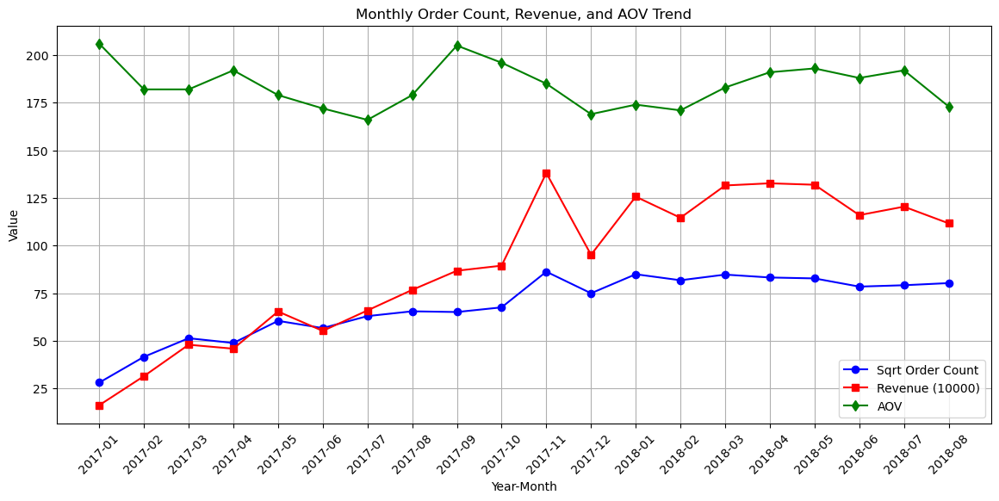

In [11]:
# year와 month를 문자열로 결합하여 x축 레이블 생성
result1["year_month"] = result1["year"].astype(str) + "-" + result1["month"].astype(str).str.zfill(2)

#회원수 조정
result1['sqrt_order_cnt'] = np.sqrt(result1['order_cnt'])

# 그래프 크기 설정
plt.figure(figsize=(14, 6))

# 주문 건수 (Order Count)
plt.plot(result1["year_month"], result1["sqrt_order_cnt"], marker="o", linestyle="-", label="Sqrt Order Count", color="blue")

# 매출 (Revenue) - 10,000 단위로 스케일 조정
plt.plot(result1["year_month"], result1["revenue"] / 10000, marker="s", linestyle="-", label="Revenue (10000)", color="red")

# AOV (Average Order Value)
plt.plot(result1["year_month"], result1["aov"], marker="d", linestyle="-", label="AOV", color="green")

# x축 라벨 회전
plt.xticks(rotation=45)

# 축 및 제목 설정
plt.xlabel("Year-Month")
plt.ylabel("Value")
plt.title("Monthly Order Count, Revenue, and AOV Trend")
plt.legend()
plt.grid(True)
plt.show()

##### seller, buyer 도시 분포

In [12]:
# 도시별 분포
customer_seller_merge = pd.merge(
customers.groupby(['customer_zip_code_prefix'])[["customer_id"]].nunique().reset_index().sort_values(by="customer_id"),
sellers.groupby(['seller_zip_code_prefix'])[["seller_id"]].nunique().sort_values(by="seller_id"),
how='inner',
left_on='customer_zip_code_prefix',
right_on='seller_zip_code_prefix'
)
customer_seller_merge.rename(columns={'customer_zip_code_prefix':'geolocation_zip_code_prefix'}, inplace=True)
geo_sell_buy_merge = pd.merge(geolocation, customer_seller_merge, how="inner", on='geolocation_zip_code_prefix')

In [13]:
# 고객 수, 판매자 수에 따라 색상을 다르게 지정
customer_layer = pdk.Layer(
    "ScatterplotLayer",
    geo_sell_buy_merge,
    get_position=["geolocation_lng", "geolocation_lat"],
    get_radius="customer_id * 500",
    get_fill_color="[0, 255, 0, 160]",  # 하늘색 (RGBA)
    pickable=True,
    opacity=0.6,
)

seller_layer = pdk.Layer(
    "ScatterplotLayer",
    geo_sell_buy_merge,
    get_position=["geolocation_lng", "geolocation_lat"],
    get_radius="seller_id * 500",
    get_fill_color="[255, 0, 255, 255]",  # 빨간색 (RGBA)
    pickable=True,
    opacity=0.6,
)

# Pydeck 뷰 설정
view_state = pdk.ViewState(
    latitude=geo_sell_buy_merge["geolocation_lat"].mean(),
    longitude=geo_sell_buy_merge["geolocation_lng"].mean(),
    zoom=5,
    pitch=0,
)

# Pydeck 맵 생성
r = pdk.Deck(
    layers=[customer_layer, seller_layer],
    initial_view_state=view_state,
    tooltip={"text": "City: {geolocation_city}\nCustomers: {customer_id}\nSellers: {seller_id}"},
)

# 맵 표시
r.show()